In [12]:
import warnings
warnings.filterwarnings('ignore')
import librosa
import IPython.display as idsp
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import os,sys

In [13]:
folder = 'Songs'
files_path = []
for song in os.listdir(folder):
    files_path.append(folder + '/' + song)
files_path

['Songs/Brown Munde - AP Dhillon.mp3',
 'Songs/Raataan Lambiyan - Shershaah.mp3',
 'Songs/Ranjha - Shershaah.mp3',
 'Songs/Sawan Mein Lag Gayi Aag - Badshah.mp3',
 'Songs/Tere Bin (Sonu Nigam).mp3']

In [25]:
## Loading few songs
print(files_path[-1][str(files_path[-1]).find('/')+1:])
idsp.Audio(files_path[-1])


Tere Bin (Sonu Nigam).mp3


In [24]:
print(files_path[0][str(files_path[0]).find('/')+1:])
idsp.Audio(files_path[0])

Brown Munde - AP Dhillon.mp3


In [16]:
## Loading the files with sampling_rate = 22050 Hz
BM_data,sr = librosa.load(files_path[0],mono=True)
ranjha,_ = librosa.load(files_path[2],mono=True)
terebin,_ = librosa.load(files_path[4],mono=True)

In [17]:
            ## Duration of each sample
            sample_duration = 1/sr
            print(f'Duration of each sample is {sample_duration:.6f} seconds.')

Duration of each sample is 0.000045 seconds.


In [18]:
## Duration of ranjha song
ranjha_size = len(ranjha)
duration = ranjha_size*sample_duration
print(f'Duration of Ranjha Song is {duration:.2f} seconds')

Duration of Ranjha Song is 228.89 seconds


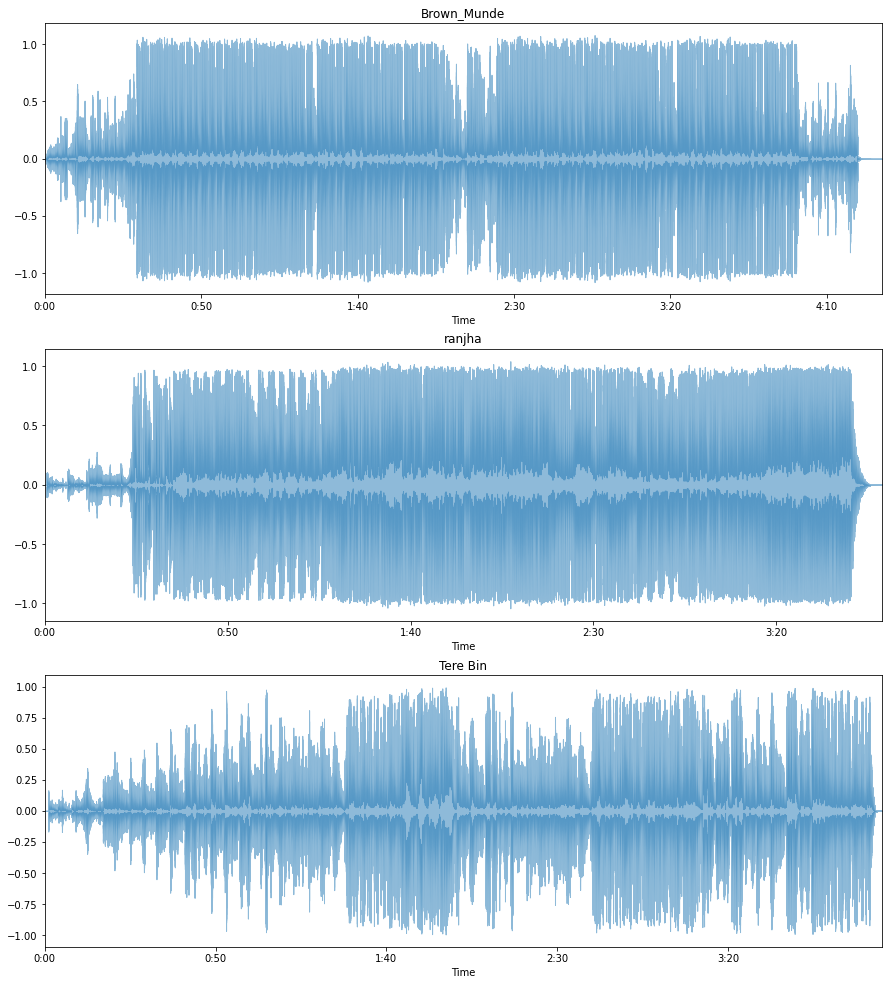

In [19]:
## Visualization of audio signal
plt.figure(figsize=(15,17))
plt.subplot(311)
librosa.display.waveplot(BM_data,sr = sr,alpha = 0.5)  ## Alpha is a parameter to make the waveplot look more intruiging
plt.title('Brown_Munde')

plt.subplot(312)
librosa.display.waveplot(ranjha,sr = sr,alpha = 0.5)
plt.title('ranjha')

plt.subplot(313)
librosa.display.waveplot(terebin,sr = sr,alpha = 0.5)
plt.title('Tere Bin')
plt.show()

In [20]:
## Amplitude Envelope for Non-overlapping frames

FRAME_SIZE = 1024
HOP_LENGTH = 256

def amplitude_env(signal,frame_size=1024):
    amplitude_envelope = []
    for i in range(0,len(signal),frame_size):
        amplitude_envelope.append(max(signal[i:i+frame_size]))
    return np.array(amplitude_envelope)

## Amplitude Envelope for Overlapping frames

def amplitude_env_overlap(signal,frame_size=FRAME_SIZE,hop_length =  HOP_LENGTH):
    amplitude_env = []
    for i in range(0,len(signal),hop_length):
        amplitude_env.append(max(signal[i:i+frame_size]))
    return np.array(amplitude_env)

## Just writing above function in list comprehension
def fancy_amplitude_env_overlap(signal,frame_size=FRAME_SIZE,hop_length =  HOP_LENGTH):
    return np.array([max(signal[i:i+frame_size]) for i in range(0,signal.size,hop_length)])

In [21]:
amplitude_env_ranjha = amplitude_env_overlap(ranjha,1024,512)
amplitude_env_terebin = amplitude_env_overlap(terebin,1024,512)
amplitude_env_BM = amplitude_env_overlap(BM_data,1024,512)

In [22]:
## Sanity Checks for amplitude_env_overlap and fancy_amplitude_env_overlap
amplitude_env_ranjha_0 = fancy_amplitude_env_overlap(ranjha,frame_size=1024,hop_length=64)
amplitude_env_ranjha_1 = amplitude_env_overlap(ranjha,frame_size=1024,hop_length=64)
print((amplitude_env_ranjha_0==amplitude_env_ranjha_1).all())
print(amplitude_env_ranjha.shape)

True
(9858,)


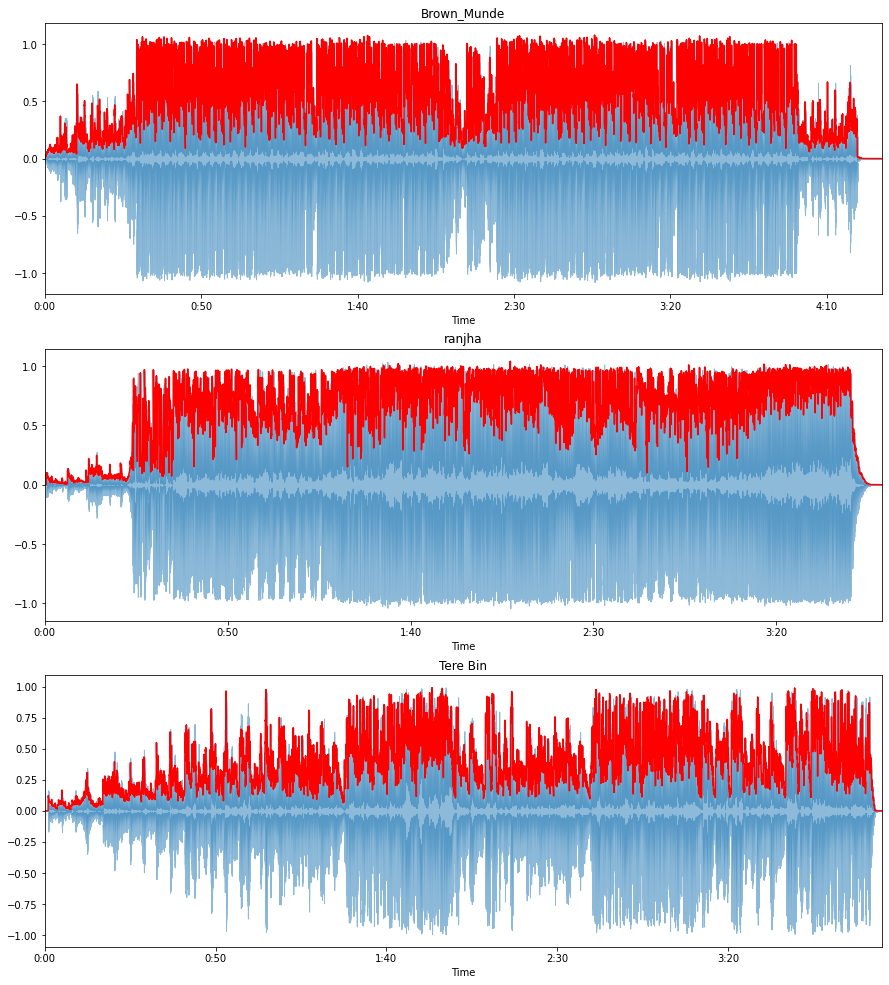

In [23]:
## Visualize Amplitude env for all signals
## Visualization of audio signal
frames_BM = range(amplitude_env_BM.shape[0])    ## Number of frames is the size of the amplitude envelope
frames_terebin = range(amplitude_env_terebin.shape[0])
frames_ranjha = range(amplitude_env_ranjha.shape[0])

t_BM = librosa.frames_to_time(frames_BM) ## Plotting those amplitude envelope on the waveplot so we need the corresponding
t_ranjha = librosa.frames_to_time(frames_ranjha) ## time for these frames this is what librosa.frames_to_times does!!
t_terebin = librosa.frames_to_time(frames_terebin)

plt.figure(figsize=(15,17))
plt.subplot(311)
librosa.display.waveplot(BM_data,sr = sr,alpha = 0.5)
plt.plot(t_BM,amplitude_env_BM,color = 'r')
plt.title('Brown_Munde')

plt.subplot(312)
librosa.display.waveplot(ranjha,sr = sr,alpha = 0.5)
plt.plot(t_ranjha,amplitude_env_ranjha,color = 'r')
plt.title('ranjha')

plt.subplot(313)
librosa.display.waveplot(terebin,sr = sr,alpha = 0.5)
plt.plot(t_terebin,amplitude_env_terebin,color = 'r')
plt.title('Tere Bin')
plt.show()